<div class="alert alert-block alert-success">
    <h1 align="center">Machine Learning in Python</h1>
    <h3 align="center">Project1</h3>
        <h4 align="center"><a href="https://www.linkedin.com/public-profile/settings?trk=d_flagship3_profile_self_view_public_profile&lipi=urn%3Ali%3Apage%3Ad_flagship3_profile_self_edit_top_card%3BhFw1W2M%2FTMCAYZp6pzKt1Q%3D%3D">Seyed Mohammad Sajadi</a></h4>
</div>

<img src = "https://www.eesc.europa.eu/sites/default/files/styles/large/public/images/shutterstock_1642888921.jpg?itok=P9-6YhGd" width=50%>

## Importing the libraries

In [1]:
import numpy as np 
import pandas as pd 
import seaborn as sns
import matplotlib.pyplot as plt


from collections import Counter
from pandas_profiling import ProfileReport
import plotly.express as px
import plotly.graph_objects as go
import matplotlib.patches as mpatches
from plotly.subplots import make_subplots
from wordcloud import WordCloud
sns.set(color_codes = True)
sns.set(style="whitegrid")
import plotly.figure_factory as ff
from plotly.colors import n_colors
import plotly.graph_objs as go
import plotly.figure_factory as ff
from plotly import tools
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
import plotly.express as px
init_notebook_mode(connected=True)
import warnings
warnings.filterwarnings("ignore")


from sklearn import metrics
from plotly.offline import iplot
from xgboost import XGBRegressor
from sklearn.svm import SVR
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import train_test_split
from sklearn.linear_model import SGDRegressor, ElasticNet, Lasso, Ridge
from sklearn.metrics import r2_score, mean_absolute_error, mean_squared_error
from sklearn.preprocessing import StandardScaler, MinMaxScaler, Normalizer, MaxAbsScaler, RobustScaler

## Load and Prepare Data

In [2]:
df=pd.read_csv("country_vaccinations.csv")
df['date'] = pd.to_datetime(df["date"])

## EDA

In [3]:
df.head()

,country,iso_code,date,total_vaccinations,people_vaccinated,people_fully_vaccinated,daily_vaccinations_raw,daily_vaccinations,total_vaccinations_per_hundred,people_vaccinated_per_hundred,people_fully_vaccinated_per_hundred,daily_vaccinations_per_million,vaccines,source_name,source_website
0,Afghanistan,AFG,2021-02-22,0.0,0.0,NaN,NaN,NaN,0.0,0.0,NaN,NaN,"Johnson&Johnson, Oxford/AstraZeneca, Pfizer/Bi...",World Health Organization,https://covid19.who.int/
1,Afghanistan,AFG,2021-02-23,NaN,NaN,NaN,NaN,1367.0,NaN,NaN,NaN,35.0,"Johnson&Johnson, Oxford/AstraZeneca, Pfizer/Bi...",World Health Organization,https://covid19.who.int/
2,Afghanistan,AFG,2021-02-24,NaN,NaN,NaN,NaN,1367.0,NaN,NaN,NaN,35.0,"Johnson&Johnson, Oxford/AstraZeneca, Pfizer/Bi...",World Health Organization,https://covid19.who.int/
3,Afghanistan,AFG,2021-02-25,NaN,NaN,NaN,NaN,1367.0,NaN,NaN,NaN,35.0,"Johnson&Johnson, Oxford/AstraZeneca, Pfizer/Bi...",World Health Organization,https://covid19.who.int/
4,Afghanistan,AFG,2021-02-26,NaN,NaN,NaN,NaN,1367.0,NaN,NaN,NaN,35.0,"Johnson&Johnson, Oxford/AstraZeneca, Pfizer/Bi...",World Health Organization,https://covid19.who.int/


In [4]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 31240 entries, 0 to 31239
Data columns (total 15 columns):
 #   Column                               Non-Null Count  Dtype         
---  ------                               --------------  -----         
 0   country                              31240 non-null  object        
 1   iso_code                             31240 non-null  object        
 2   date                                 31240 non-null  datetime64[ns]
 3   total_vaccinations                   17451 non-null  float64       
 4   people_vaccinated                    16554 non-null  float64       
 5   people_fully_vaccinated              13795 non-null  float64       
 6   daily_vaccinations_raw               14421 non-null  float64       
 7   daily_vaccinations                   30948 non-null  float64       
 8   total_vaccinations_per_hundred       17451 non-null  float64       
 9   people_vaccinated_per_hundred        16554 non-null  float64       
 10  people_ful

## Data Preprocessing

In [5]:
df.isnull().sum()

country                                    0
iso_code                                   0
date                                       0
total_vaccinations                     13789
people_vaccinated                      14686
people_fully_vaccinated                17445
daily_vaccinations_raw                 16819
daily_vaccinations                       292
total_vaccinations_per_hundred         13789
people_vaccinated_per_hundred          14686
people_fully_vaccinated_per_hundred    17445
daily_vaccinations_per_million           292
vaccines                                   0
source_name                                0
source_website                             0
dtype: int64

In [6]:
# df.drop(["source_name","source_website","total_vaccinations","people_fully_vaccinated","daily_vaccinations_raw","total_vaccinations_per_hundred","people_fully_vaccinated_per_hundred"],axis=1, inplace=True)
# df.head()

In [7]:
report = ProfileReport(df)
report

Summarize dataset:   0%|          | 0/28 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [8]:
df['iso_code'] = df['iso_code'].fillna('GBR')

In [9]:
df['date'] = pd.to_datetime(df['date'])
df = df.sort_values('date', ascending=True)

df['date'] = df['date'].dt.strftime('%m-%d-%Y')

df.head()

,country,iso_code,date,total_vaccinations,people_vaccinated,people_fully_vaccinated,daily_vaccinations_raw,daily_vaccinations,total_vaccinations_per_hundred,people_vaccinated_per_hundred,people_fully_vaccinated_per_hundred,daily_vaccinations_per_million,vaccines,source_name,source_website
21109,Norway,NOR,12-02-2020,0.0,0.0,NaN,NaN,NaN,0.0,0.0,NaN,NaN,"Moderna, Pfizer/BioNTech",Norwegian Institute of Public Health,https://www.fhi.no/sv/vaksine/koronavaksinasjo...
21110,Norway,NOR,12-03-2020,0.0,0.0,NaN,0.0,0.0,0.0,0.0,NaN,0.0,"Moderna, Pfizer/BioNTech",Norwegian Institute of Public Health,https://www.fhi.no/sv/vaksine/koronavaksinasjo...
21111,Norway,NOR,12-04-2020,0.0,0.0,NaN,0.0,0.0,0.0,0.0,NaN,0.0,"Moderna, Pfizer/BioNTech",Norwegian Institute of Public Health,https://www.fhi.no/sv/vaksine/koronavaksinasjo...
15554,Latvia,LVA,12-04-2020,1.0,1.0,NaN,NaN,NaN,0.0,0.0,NaN,NaN,"Johnson&Johnson, Moderna, Oxford/AstraZeneca, ...",National Health Service,https://data.gov.lv/dati/eng/dataset/covid19-v...
21112,Norway,NOR,12-05-2020,0.0,0.0,NaN,0.0,0.0,0.0,0.0,NaN,0.0,"Moderna, Pfizer/BioNTech",Norwegian Institute of Public Health,https://www.fhi.no/sv/vaksine/koronavaksinasjo...


In [10]:
India=df[df['iso_code']=='IND']
df['country'].value_counts().head(20)

Norway              226
Latvia              224
England             220
Scotland            220
United Kingdom      215
Wales               215
Northern Ireland    215
Canada              214
China               213
Russia              213
Denmark             211
Israel              209
United States       208
Switzerland         206
Liechtenstein       206
Qatar               206
Bahrain             205
Mexico              203
Costa Rica          202
Cayman Islands      202
Name: country, dtype: int64

In [11]:
country_vaccine = df.groupby(["country", "iso_code", "vaccines"])['total_vaccinations', 
                                                                       'total_vaccinations_per_hundred',
                                                                      'daily_vaccinations',
                                                                      'daily_vaccinations_per_million',
                                                                      'people_vaccinated',
                                                                      'people_vaccinated_per_hundred',
                                                                       'people_fully_vaccinated', 'people_fully_vaccinated_per_hundred'
                                                                      ].max().reset_index()
country_vaccine.columns = ["Country", "iso_code", "Vaccines", "Total vaccinations", "Percent", "Daily vaccinations", 
                           "Daily vaccinations per million", "People vaccinated", "People vaccinated per hundred",
                           'People fully vaccinated', 'People fully vaccinated percent']


vaccines = country_vaccine.Vaccines.unique()
for v in vaccines:
    countries = country_vaccine.loc[country_vaccine.Vaccines==v, 'Country'].values
    print(f"Vaccines: {v}: \nCountries: {list(countries)}\n")

Vaccines: Johnson&Johnson, Oxford/AstraZeneca, Pfizer/BioNTech, Sinopharm/Beijing: 
Countries: ['Afghanistan']

Vaccines: Oxford/AstraZeneca, Pfizer/BioNTech, Sinovac, Sputnik V: 
Countries: ['Albania', 'Bosnia and Herzegovina', 'Oman', 'Tunisia']

Vaccines: Oxford/AstraZeneca, Sputnik V: 
Countries: ['Algeria', 'Ghana', 'Guyana', 'Kenya', 'Nicaragua']

Vaccines: Oxford/AstraZeneca, Pfizer/BioNTech: 
Countries: ['Andorra', 'Australia', 'Bermuda', 'Bhutan', 'Cape Verde', 'Cayman Islands', 'Costa Rica', 'Isle of Man', 'Panama', 'Saudi Arabia', 'Slovenia', 'Sweden']

Vaccines: Oxford/AstraZeneca: 
Countries: ['Angola', 'Anguilla', 'Antigua and Barbuda', 'Bahamas', 'Barbados', 'Botswana', 'British Virgin Islands', 'Burkina Faso', 'Cook Islands', "Cote d'Ivoire", 'Democratic Republic of Congo', 'Eswatini', 'Ethiopia', 'Falkland Islands', 'Fiji', 'French Polynesia', 'Georgia', 'Grenada', 'Jamaica', 'Kosovo', 'Lesotho', 'Liberia', 'Madagascar', 'Malawi', 'Mali', 'Montserrat', 'Nauru', 'Nigeri

In [12]:
fig = px.choropleth(locations=country_vaccine['Country'], 
                    locationmode="country names",
                    color=country_vaccine['Vaccines'],
                    title="Countries using each vaccine (different colors for each vaccine)",
                    height = 800
                   )
fig.update_layout({'legend_orientation':'v'})
fig.update_layout({'legend_title':'Vaccine scheme'})
fig.show()

In [13]:
vaccine = df.groupby(["vaccines"])['total_vaccinations','total_vaccinations_per_hundred',
                                       'daily_vaccinations','daily_vaccinations_per_million'].max().reset_index()
vaccine.columns = ["Vaccines", "Total vaccinations", "Percent", "Daily vaccinations", 
                           "Daily vaccinations per million"]
def draw_trace_bar_vaccine(data, feature, title, xlab, ylab,color='Blue'):
    data = data.sort_values(feature, ascending=False)
    trace = go.Bar(
            x = data['Vaccines'],
            y = data[feature],
            marker=dict(color=color),
            text=data['Vaccines']
        )
    data = [trace]

    layout = dict(title = title,
              xaxis = dict(title = xlab, showticklabels=True, tickangle=45, 
                           zeroline=True, zerolinewidth=1, zerolinecolor='grey',
                           showline=True, linewidth=2, linecolor='black', mirror=True,
                          tickfont=dict(
                            size=10,
                            color='black'),), 
              yaxis = dict(title = ylab, gridcolor='lightgrey', zeroline=True, zerolinewidth=1, zerolinecolor='grey',
                          showline=True, linewidth=2, linecolor='black', mirror=True),
              plot_bgcolor = 'rgba(0, 0, 0, 0)', paper_bgcolor = 'rgba(0, 0, 0, 0)',
              hovermode = 'closest',
              height = 800
             )
    fig = dict(data = data, layout = layout)
    iplot(fig, filename='draw_trace')
    
draw_trace_bar_vaccine(vaccine, 'Total vaccinations', 'Total per vaccine scheme', 'Vaccine', 'Vaccination total', "darkmagenta" )

In [14]:
fig = px.treemap(country_vaccine, path = ['Vaccines', 'Country'], values = 'Total vaccinations',
                title="Total vaccinations per country, grouped by vaccine scheme")
fig.show()

In [15]:
fig = px.treemap(country_vaccine, path = ['Vaccines', 'Country'], values = 'Daily vaccinations',
                title="Daily vaccinations per country, grouped by vaccine scheme")
fig.show()

In [16]:
fig = px.treemap(country_vaccine, path = ['Vaccines', 'Country'], values = 'People vaccinated',
                title="People vaccinated per country, grouped by vaccine scheme")
fig.show()

In [17]:
def draw_trace_bar(data, feature, title, xlab, ylab,color='Blue'):
    data = data.sort_values(feature, ascending=False)
    trace = go.Bar(
            x = data['Country'],
            y = data[feature],
            marker=dict(color=color),
            text=data['Country']
        )
    data = [trace]

    layout = dict(title = title,
              xaxis = dict(title = xlab, showticklabels=True, tickangle=45, 
                           zeroline=True, zerolinewidth=1, zerolinecolor='grey',
                           showline=True, linewidth=2, linecolor='black', mirror=True,
                          tickfont=dict(
                            size=10,
                            color='black'),), 
              yaxis = dict(title = ylab, gridcolor='lightgrey', zeroline=True, zerolinewidth=1, zerolinecolor='grey',
                          showline=True, linewidth=2, linecolor='black', mirror=True),
              plot_bgcolor = 'rgba(0, 0, 0, 0)', paper_bgcolor = 'rgba(0, 0, 0, 0)',
              hovermode = 'closest'
             )
    fig = dict(data = data, layout = layout)
    iplot(fig, filename='draw_trace')
    
draw_trace_bar(country_vaccine, 'Total vaccinations', 'Vaccination total per country', 'Country', 'Vaccination total', "Darkgreen" )

In [18]:
draw_trace_bar(country_vaccine, 'Percent', 'Vaccination percent per country', 'Country', 'Vaccination percent' )

In [19]:
draw_trace_bar(country_vaccine, 'Daily vaccinations', 'Daily vaccinations per country', 'Country', 'Daily vaccinations', "red" )

In [20]:
draw_trace_bar(country_vaccine, 'Daily vaccinations per million', 'Daily vaccinations per million per country', 'Country',\
               'Daily vaccinations per million', "magenta" )

In [21]:
draw_trace_bar(country_vaccine, 'People vaccinated', 'People vaccinated per country', 'Country',\
               'People vaccinated', "lightblue" )

In [22]:
draw_trace_bar(country_vaccine, 'People vaccinated per hundred', 'People vaccinated per hundred per country', 'Country',\
               'People vaccinated per hundred', "orange" )

In [23]:
def plot_custom_scatter(df, x, y, size, color, hover_name, title):
    fig = px.scatter(df, x=x, y=y, size=size, color=color,
               hover_name=hover_name, size_max=80, title = title)
    fig.update_layout({'legend_orientation':'h'})
    fig.update_layout(legend=dict(yanchor="top", y=-0.2))
    fig.update_layout({'legend_title':'Vaccine scheme'})
    fig.update_layout({'plot_bgcolor': 'rgba(0, 0, 0, 0)','paper_bgcolor': 'rgba(0, 0, 0, 0)'})
    fig.update_xaxes(showline=True, linewidth=2, linecolor='black', mirror=True)
    fig.update_yaxes(showline=True, linewidth=2, linecolor='black', mirror=True)
    fig.update_xaxes(zeroline=True, zerolinewidth=1, zerolinecolor='grey')
    fig.update_yaxes(zeroline=True, zerolinewidth=1, zerolinecolor='grey')
    fig.update_xaxes(showgrid=True, gridwidth=1, gridcolor='lightgrey')
    fig.update_yaxes(showgrid=True, gridwidth=1, gridcolor='lightgrey')
    fig.show()    

plot_custom_scatter(country_vaccine, x="Total vaccinations", y="Percent", size="Total vaccinations", color="Vaccines",
           hover_name="Country", title = "Vaccinations (Percent vs. total), grouped per country and vaccines")

In [24]:
plot_custom_scatter(country_vaccine, x="Total vaccinations", y="Daily vaccinations", size="Total vaccinations", color="Vaccines",
           hover_name="Country", title = "Vaccinations (Total vs. Daily) grouped per country and vaccines")

In [25]:
plot_custom_scatter(country_vaccine, x="Percent", y="Daily vaccinations per million", size="Total vaccinations", color="Vaccines",
           hover_name="Country", title = "Vaccinations (Daily / million vs. Percent) grouped per country and vaccines")

In [26]:
trace = go.Choropleth(
            locations = country_vaccine['Country'],
            locationmode='country names',
            z = country_vaccine['Total vaccinations'],
            text = country_vaccine['Country'],
            autocolorscale =False,
            reversescale = True,
            colorscale = 'viridis',
            marker = dict(
                line = dict(
                    color = 'rgb(0,0,0)',
                    width = 0.5)
            ),
            colorbar = dict(
                title = 'Total vaccinations',
                tickprefix = '')
        )

data = [trace]
layout = go.Layout(
    title = 'Total vaccinations per country',
    geo = dict(
        showframe = True,
        showlakes = False,
        showcoastlines = True,
        projection = dict(
            type = 'natural earth'
        )
    )
)

fig = dict( data=data, layout=layout )
iplot(fig)

In [27]:
trace = go.Choropleth(
            locations = country_vaccine['Country'],
            locationmode='country names',
            z = country_vaccine['Percent'],
            text = country_vaccine['Country'],
            autocolorscale =False,
            reversescale = True,
            colorscale = 'viridis',
            marker = dict(
                line = dict(
                    color = 'rgb(0,0,0)',
                    width = 0.5)
            ),
            colorbar = dict(
                title = 'Percent',
                tickprefix = '')
        )

data = [trace]
layout = go.Layout(
    title = 'Total vaccinations per hundred per country',
    geo = dict(
        showframe = True,
        showlakes = False,
        showcoastlines = True,
        projection = dict(
            type = 'natural earth'
        )
    )
)

fig = dict( data=data, layout=layout )
iplot(fig)

In [28]:
trace = go.Choropleth(
            locations = country_vaccine['Country'],
            locationmode='country names',
            z = country_vaccine['Daily vaccinations'],
            text = country_vaccine['Country'],
            autocolorscale =False,
            reversescale = True,
            colorscale = 'viridis',
            marker = dict(
                line = dict(
                    color = 'rgb(0,0,0)',
                    width = 0.5)
            ),
            colorbar = dict(
                title = 'Daily vaccinations',
                tickprefix = '')
        )

data = [trace]
layout = go.Layout(
    title = 'Daily vaccinations per country',
    geo = dict(
        showframe = True,
        showlakes = False,
        showcoastlines = True,
        projection = dict(
            type = 'natural earth'
        )
    )
)

fig = dict( data=data, layout=layout )
iplot(fig)

In [29]:
trace = go.Choropleth(
            locations = country_vaccine['Country'],
            locationmode='country names',
            z = country_vaccine['Daily vaccinations per million'],
            text = country_vaccine['Country'],
            autocolorscale =False,
            reversescale = True,
            colorscale = 'viridis',
            marker = dict(
                line = dict(
                    color = 'rgb(0,0,0)',
                    width = 0.5)
            ),
            colorbar = dict(
                title = 'Daily vaccinations per million',
                tickprefix = '')
        )

data = [trace]
layout = go.Layout(
    title = 'Daily vaccinations per million per country',
    geo = dict(
        showframe = True,
        showlakes = False,
        showcoastlines = True,
        projection = dict(
            type = 'natural earth'
        )
    )
)

fig = dict( data=data, layout=layout )
iplot(fig)

In [30]:
trace = go.Choropleth(
            locations = country_vaccine['Country'],
            locationmode='country names',
            z = country_vaccine['People vaccinated'],
            text = country_vaccine['Country'],
            autocolorscale =False,
            reversescale = True,
            colorscale = 'viridis',
            marker = dict(
                line = dict(
                    color = 'rgb(0,0,0)',
                    width = 0.5)
            ),
            colorbar = dict(
                title = 'People vaccinated',
                tickprefix = '')
        )

data = [trace]
layout = go.Layout(
    title = 'People vaccinated per country',
    geo = dict(
        showframe = True,
        showlakes = False,
        showcoastlines = True,
        projection = dict(
            type = 'natural earth'
        )
    )
)

fig = dict( data=data, layout=layout )
iplot(fig)

In [31]:
trace = go.Choropleth(
            locations = country_vaccine['Country'],
            locationmode='country names',
            z = country_vaccine['People vaccinated per hundred'],
            text = country_vaccine['Country'],
            autocolorscale =False,
            reversescale = True,
            colorscale = 'viridis',
            marker = dict(
                line = dict(
                    color = 'rgb(0,0,0)',
                    width = 0.5)
            ),
            colorbar = dict(
                title = 'People vaccinated per hundred',
                tickprefix = '')
        )

data = [trace]
layout = go.Layout(
    title = 'People vaccinated per hundred per country',
    geo = dict(
        showframe = True,
        showlakes = False,
        showcoastlines = True,
        projection = dict(
            type = 'natural earth'
        )
    )
)

fig = dict( data=data, layout=layout )
iplot(fig)

In [32]:
country_vaccine_time = df[["country", "vaccines", "date", 'total_vaccinations', 
                                'total_vaccinations_per_hundred',  'people_vaccinated','people_vaccinated_per_hundred',
                               'daily_vaccinations','daily_vaccinations_per_million', 
                                'people_fully_vaccinated', 'people_fully_vaccinated_per_hundred'
                               ]].dropna()
country_vaccine_time.columns = ["Country", "Vaccines", "Date", 'Total vaccinations', 'Percent', 'People vaccinated', 'People percent',
                               "Daily vaccinations", "Daily vaccinations per million", 
                                'People fully vaccinated', 'People fully vaccinated percent']


countries = ['Austria', 'Belgium', 'Bulgaria','Croatia', 'Cyprus', 'Czechia', 'Denmark', 'Estonia', 'Finland', 'France', 'Germany',
             'Greece', 'Hungary', 'Ireland', 'Israel', 'Italy', 'Latvia','Lithuania', 'Luxembourg', 'Malta',
             'Netherlands', 'Norway','Poland', 'Portugal', 'Romania', 'Serbia', 'Slovakia', 'Spain', 'Sweden',
             'United Kingdom', 'United States', 'China']

def plot_time_variation_countries_group(data_df, feature, title, countries):
    data = []
    for country in countries:
        df = data_df.loc[data_df.Country==country]
        trace = go.Scatter(
            x = df['Date'],y = df[feature],
            name=country,
            mode = "markers+lines",
            marker_line_width = 1,
            marker_size = 8,
            marker_symbol = 'circle',
            text=df['Country'])
        data.append(trace)
    layout = dict(title = title,
          xaxis = dict(title = 'Date', showticklabels=True,zeroline=True, zerolinewidth=1, zerolinecolor='grey',
                       showline=True, linewidth=2, linecolor='black', mirror=True,
                       tickfont=dict(size=10,color='darkblue'),), 
          yaxis = dict(title = feature, gridcolor='lightgrey', zeroline=True, zerolinewidth=1, zerolinecolor='grey',
                       showline=True, linewidth=2, linecolor='black', mirror=True, type="log"),
                       plot_bgcolor = 'rgba(0, 0, 0, 0)', paper_bgcolor = 'rgba(0, 0, 0, 0)',
         hovermode = 'x', 
         height=800
         )
    fig = dict(data=data, layout=layout)
    iplot(fig, filename='all_countries')
    
    
plot_time_variation_countries_group(country_vaccine_time, 'Percent', 'Total vaccination percent evolution (selected countries, log scale)', countries)


In [33]:
plot_time_variation_countries_group(country_vaccine_time, 'Total vaccinations', 'Total vaccination evolution (selected countries, log scale)', countries)

In [34]:
plot_time_variation_countries_group(country_vaccine_time, 'People percent', 'People vaccinated percent evolution (selected countries, log scale)', countries)

In [35]:
plot_time_variation_countries_group(country_vaccine_time, 'People vaccinated', 'People vaccinated evolution (selected countries, log scale)', countries)

In [36]:
plot_time_variation_countries_group(country_vaccine_time, 'Daily vaccinations', 'Daily vaccinations evolution (selected countries, log scale)', countries)

In [37]:
plot_time_variation_countries_group(country_vaccine_time, 'Daily vaccinations per million', 'Daily vaccinations per million evolution (selected countries, log scale)', countries)

In [38]:
plot_time_variation_countries_group(country_vaccine_time, 'People fully vaccinated percent', 'People fully vaccinated percent evolution (selected countries, log scale)', countries)

In [39]:
plot_time_variation_countries_group(country_vaccine_time, 'People fully vaccinated', 'People fully vaccinated evolution (selected countries, log scale)', countries)

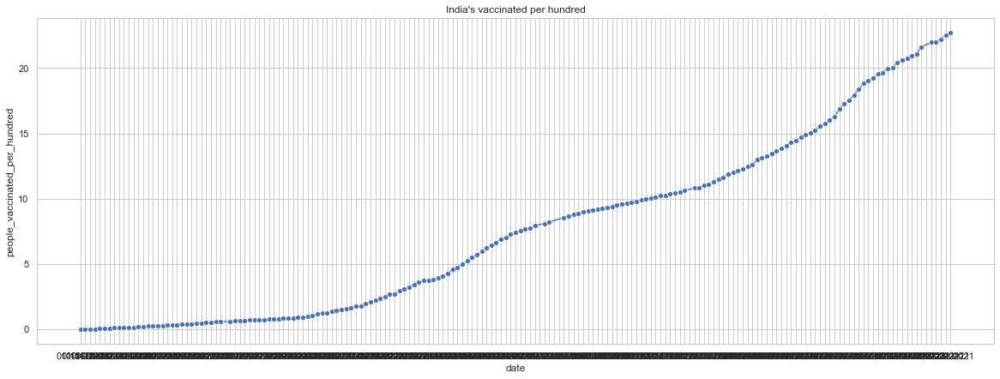

In [40]:
# INDIA

df_India = df[df["iso_code"] == 'IND'].copy()
plt.figure(figsize=(20,7))
sns.lineplot(data=df_India,x="date",y="people_vaccinated_per_hundred",marker='o')
plt.title("India's vaccinated per hundred")
plt.show()

<AxesSubplot:xlabel='date', ylabel='daily_vaccinations_per_million'>

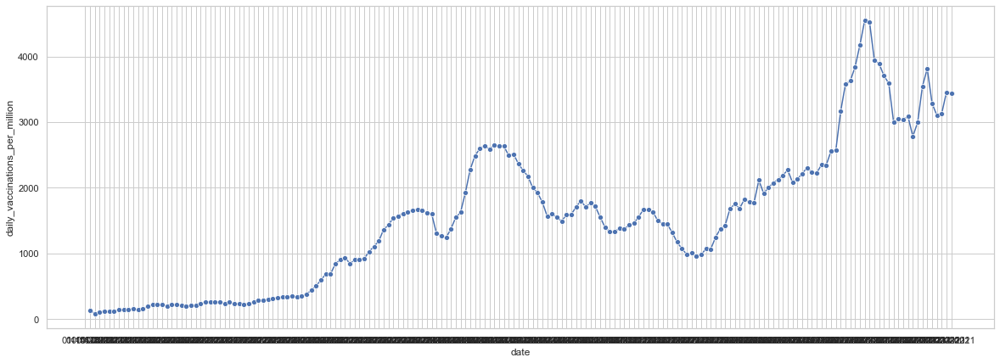

In [41]:
plt.figure(figsize=(20,7))
sns.lineplot(data=df_India,x="date",y="daily_vaccinations_per_million",marker='o')

<AxesSubplot:xlabel='date', ylabel='daily_vaccinations'>

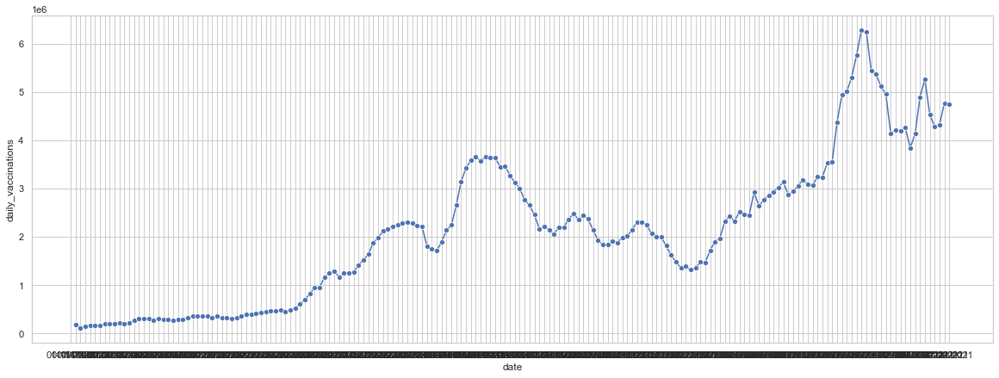

In [42]:
plt.figure(figsize=(20,7))
sns.lineplot(data=df_India,x="date",y="daily_vaccinations",marker='o')

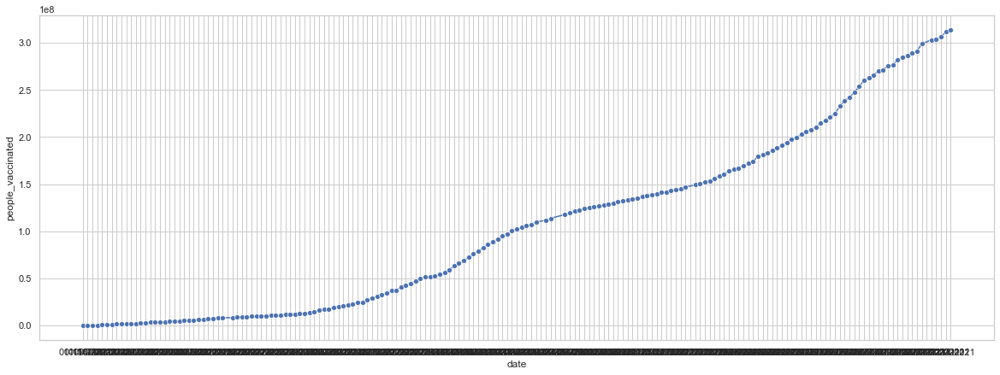

In [43]:
plt.figure(figsize=(20,7))
sns.lineplot(data=df_India,x="date",y="people_vaccinated",marker='o')
plt.show()

In [44]:
# CHINA


df_China = df[df["iso_code"] == 'CHN']
#plt.figure(figsize=(20,7))
#sns.lineplot(data=df_China,x="date",y="people_vaccinated_per_hundred",marker='o')
#plt.title("China's vaccinated per hundred")
#plt.show()

<AxesSubplot:xlabel='date', ylabel='daily_vaccinations_per_million'>

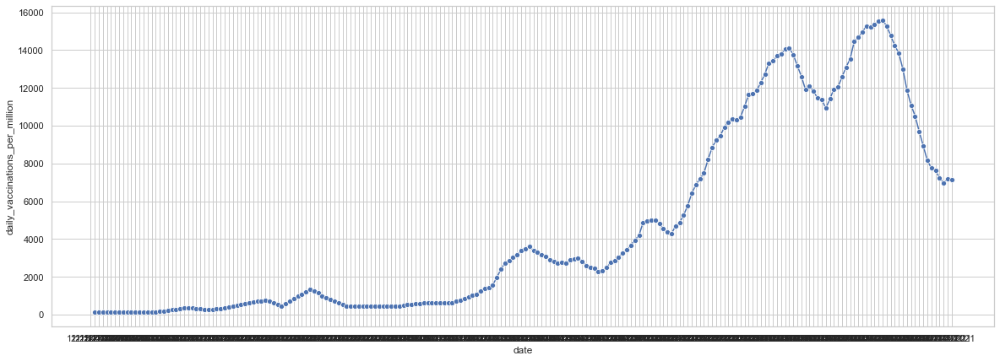

In [45]:
plt.figure(figsize=(20,7))
sns.lineplot(data=df_China,x="date",y="daily_vaccinations_per_million",marker='o')

<AxesSubplot:xlabel='date', ylabel='daily_vaccinations'>

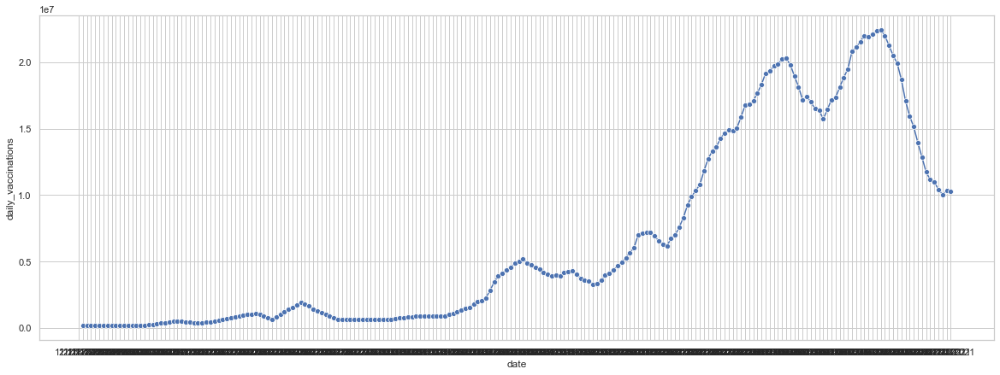

In [46]:
plt.figure(figsize=(20,7))
sns.lineplot(data=df_China,x="date",y="daily_vaccinations",marker='o')

In [47]:
#plt.figure(figsize=(20,7))
#sns.lineplot(data=df_China,x="date",y="people_vaccinated",marker='o')

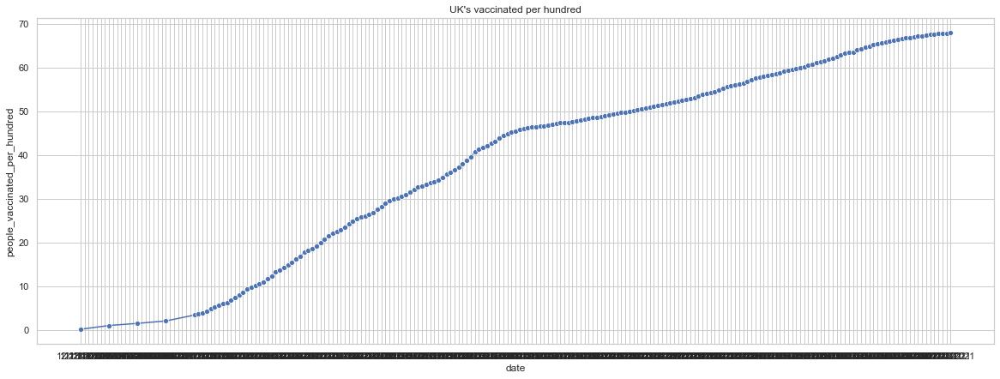

In [48]:
# UNITED KINGDOM



df_UK= df[df["iso_code"] == 'GBR'].copy()
plt.figure(figsize=(20,7))
sns.lineplot(data=df_UK,x="date",y="people_vaccinated_per_hundred",marker='o')
plt.title("UK's vaccinated per hundred")
plt.show()

<AxesSubplot:xlabel='date', ylabel='daily_vaccinations_per_million'>

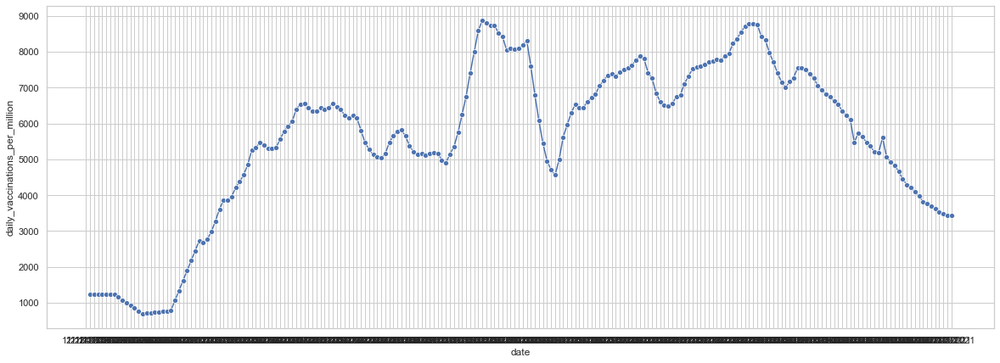

In [49]:
plt.figure(figsize=(20,7))
sns.lineplot(data=df_UK,x="date",y="daily_vaccinations_per_million",marker='o')

<AxesSubplot:xlabel='date', ylabel='daily_vaccinations'>

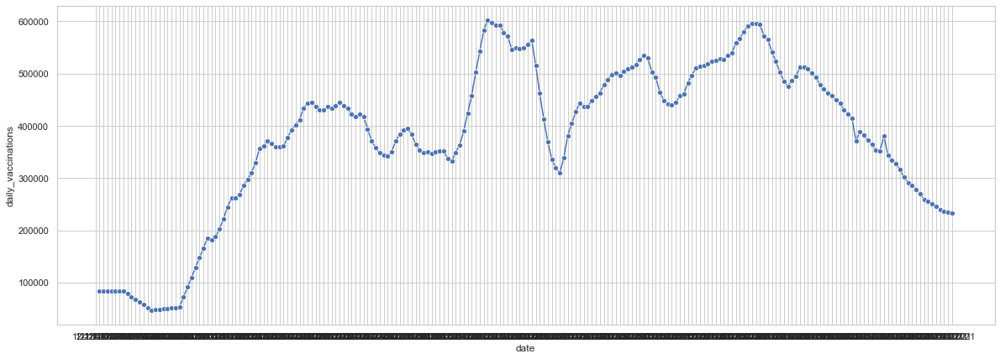

In [50]:
plt.figure(figsize=(20,7))
sns.lineplot(data=df_UK,x="date",y="daily_vaccinations",marker='o')

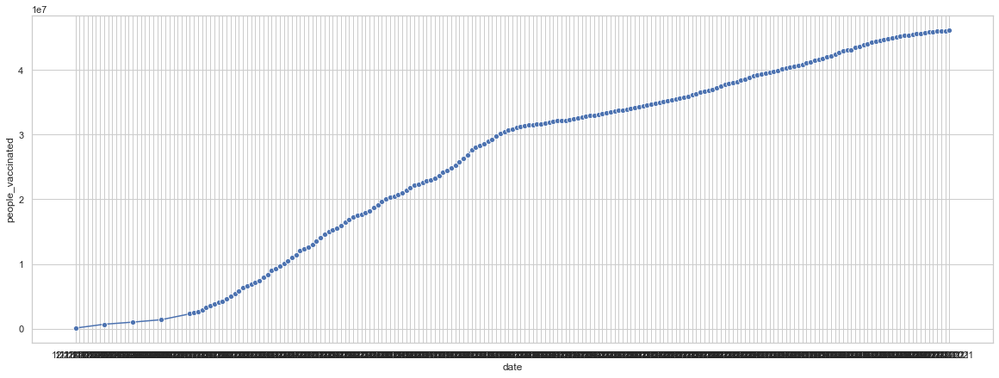

In [51]:
plt.figure(figsize=(20,7))
sns.lineplot(data=df_UK,x="date",y="people_vaccinated",marker='o')
plt.show()

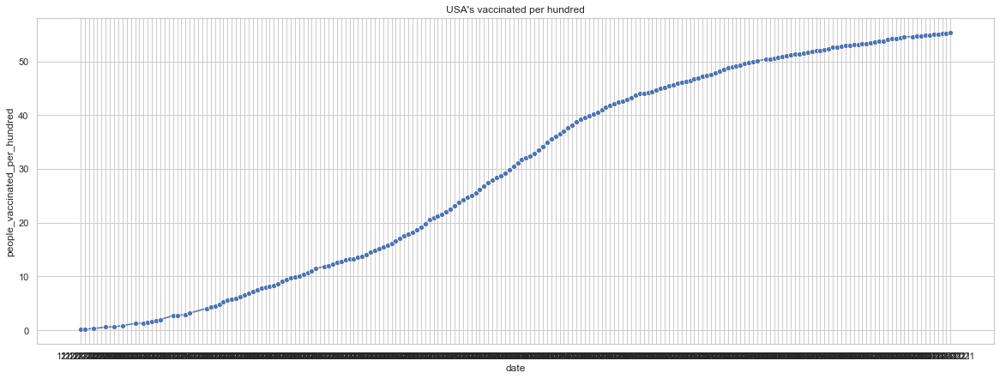

In [52]:
# UNITED STATES


df_USA = df[df["iso_code"] == 'USA'].copy()
plt.figure(figsize=(20,7))
sns.lineplot(data=df_USA,x="date",y="people_vaccinated_per_hundred",marker='o')
plt.title("USA's vaccinated per hundred")
plt.show()

<AxesSubplot:xlabel='date', ylabel='daily_vaccinations_per_million'>

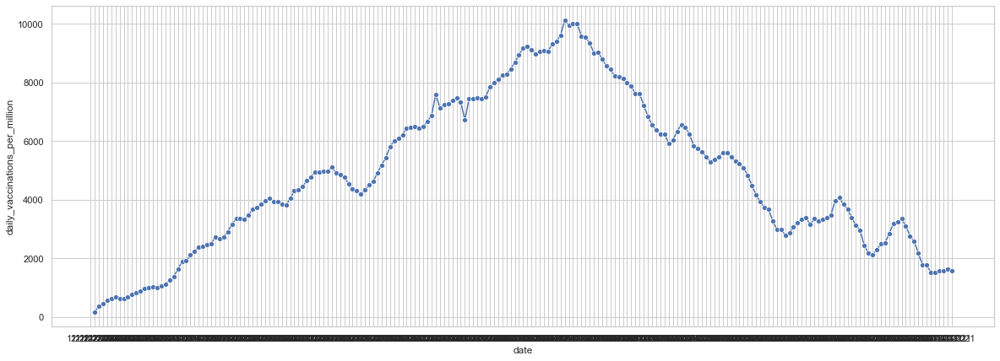

In [53]:
plt.figure(figsize=(20,7))
sns.lineplot(data=df_USA,x="date",y="daily_vaccinations_per_million",marker='o')

<AxesSubplot:xlabel='date', ylabel='daily_vaccinations'>

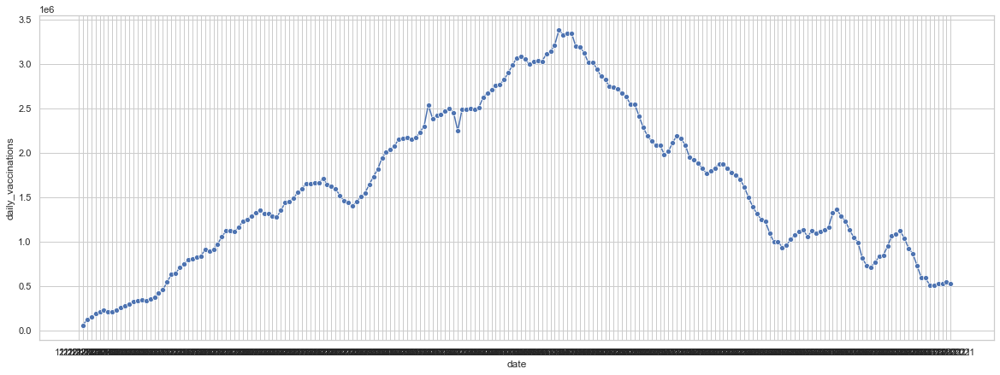

In [54]:
plt.figure(figsize=(20,7))
sns.lineplot(data=df_USA,x="date",y="daily_vaccinations",marker='o')

<AxesSubplot:xlabel='date', ylabel='people_vaccinated'>

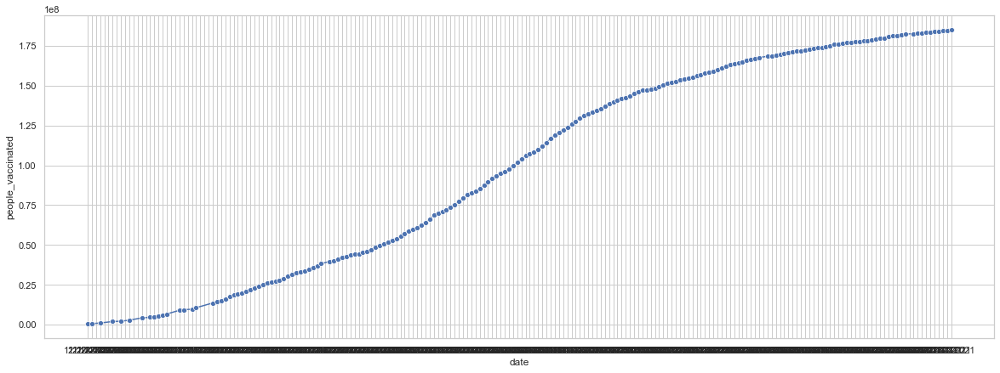

In [55]:
plt.figure(figsize=(20,7))
sns.lineplot(data=df_USA,x="date",y="people_vaccinated",marker='o')

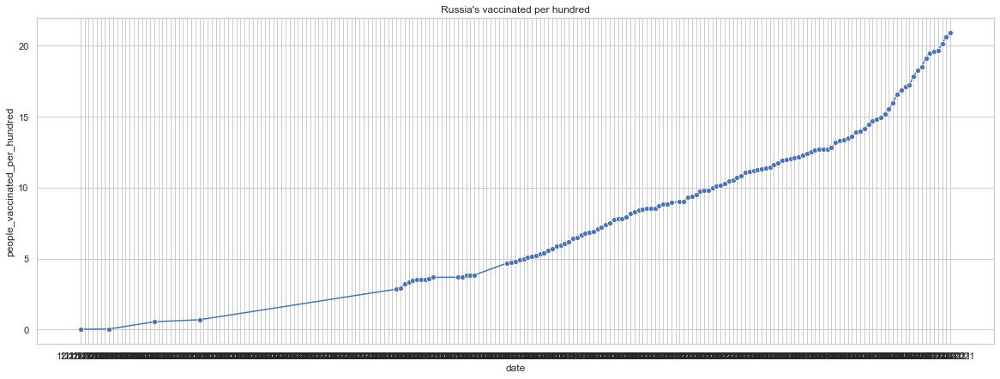

In [56]:
# RUSSIA


df_Russia = df[df["iso_code"] == 'RUS'].copy()
plt.figure(figsize=(20,7))
sns.lineplot(data=df_Russia,x="date",y="people_vaccinated_per_hundred",marker='o')
plt.title("Russia's vaccinated per hundred")
plt.show()

<AxesSubplot:xlabel='date', ylabel='daily_vaccinations_per_million'>

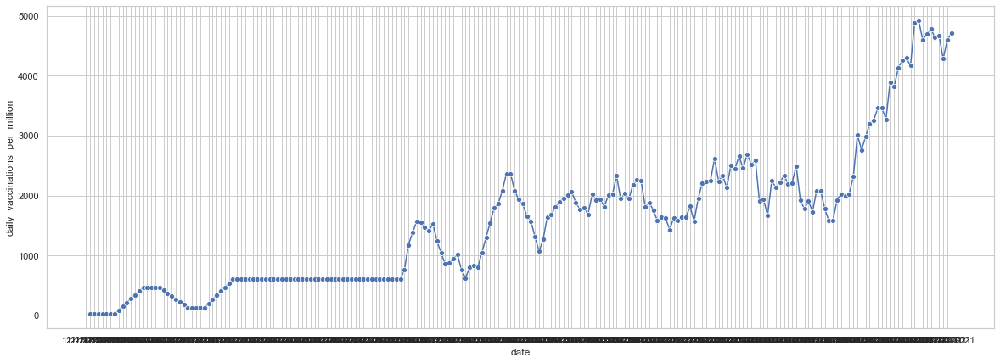

In [57]:
plt.figure(figsize=(20,7))
sns.lineplot(data=df_Russia,x="date",y="daily_vaccinations_per_million",marker='o')

<AxesSubplot:xlabel='date', ylabel='daily_vaccinations'>

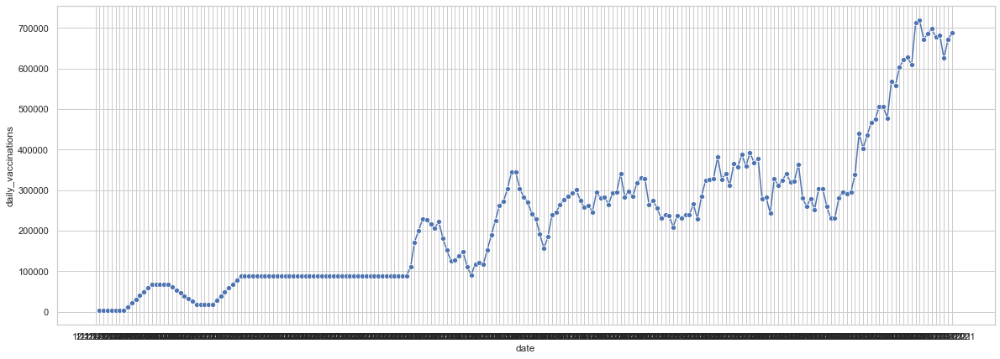

In [58]:
plt.figure(figsize=(20,7))
sns.lineplot(data=df_Russia,x="date",y="daily_vaccinations",marker='o')

<AxesSubplot:xlabel='date', ylabel='people_vaccinated'>

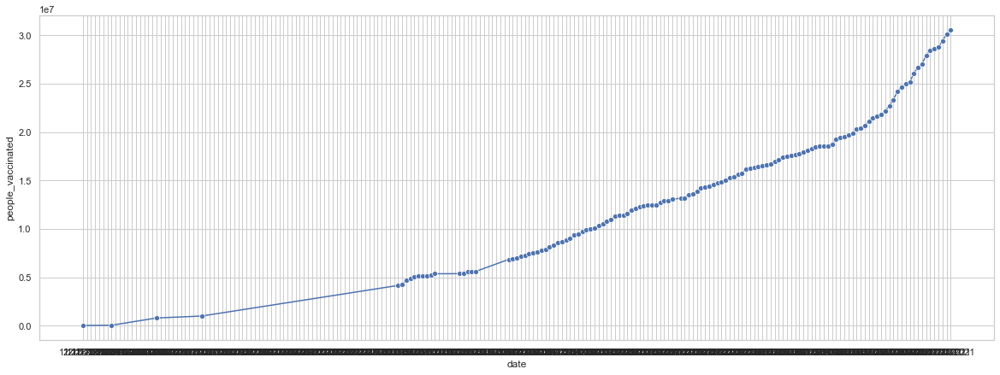

In [59]:
plt.figure(figsize=(20,7))
sns.lineplot(data=df_Russia,x="date",y="people_vaccinated",marker='o')

## Strorytelling - Visualization

In [60]:
# Countries Developing Vaccine


df_developed = df[(df["country"]=="United States") |(df["country"]=="China")|(df["country"]=='United Kingdom') |(df["country"]=='Russia')|(df["country"]=='India')]

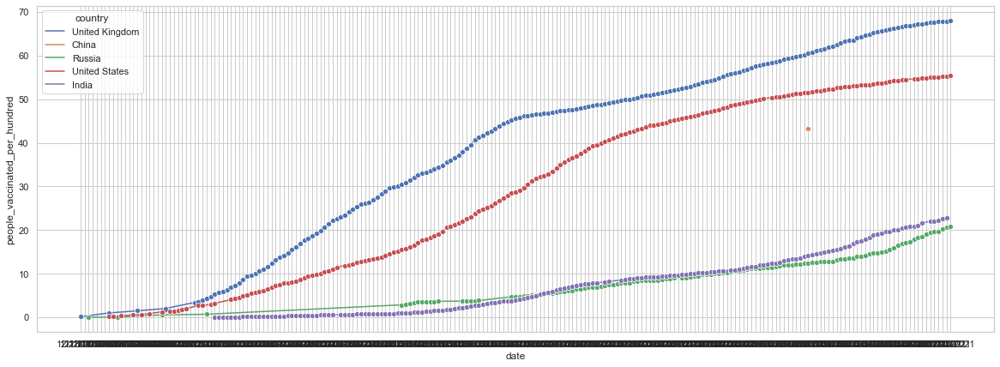

In [61]:
plt.figure(figsize=(20,7))
sns.lineplot(data=df_developed,x="date",y="people_vaccinated_per_hundred",marker='o',hue="country")
plt.show()

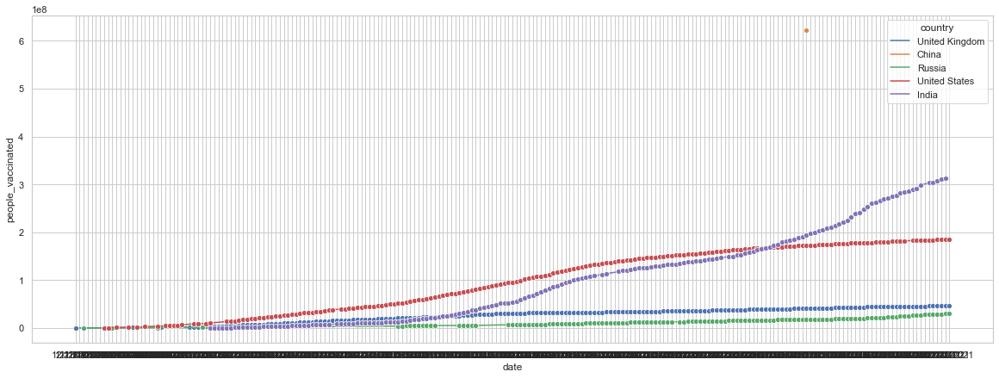

In [62]:
# People Vaccinated

plt.figure(figsize=(20,7))
sns.lineplot(data=df_developed,x="date",y="people_vaccinated",marker='o',hue="country")
plt.show()

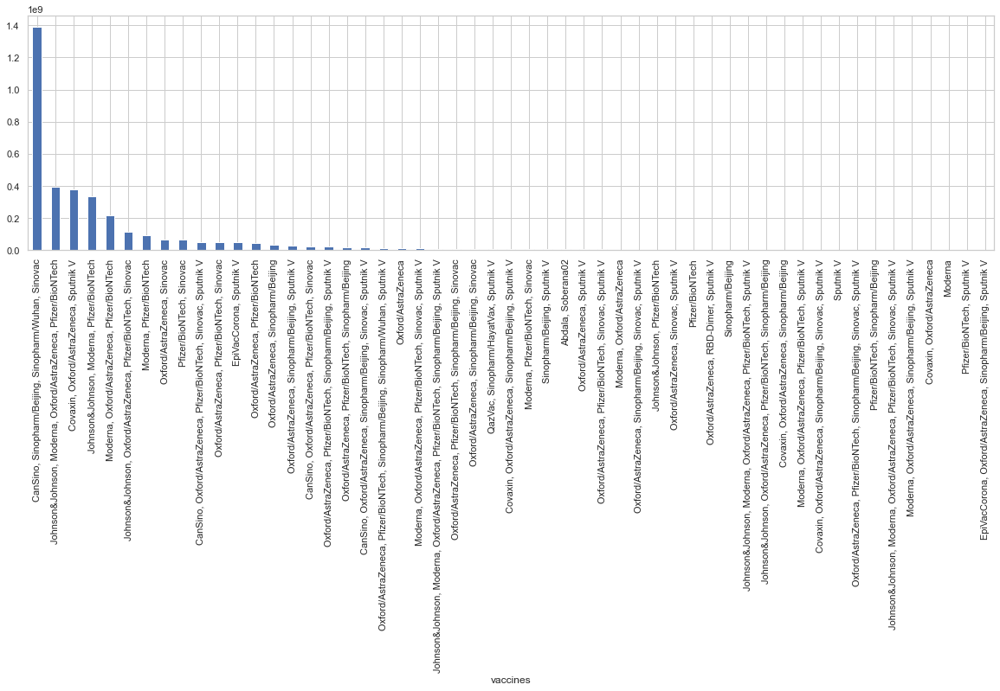

In [63]:
# Vaccine They Get


plt.figure(figsize=(20,5))
df_vaccines = df[["country","daily_vaccinations","vaccines"]].copy()
df_group = df_vaccines.groupby("vaccines")["daily_vaccinations"].sum()
df_group = df_group.sort_values(ascending=False).plot.bar()

In [64]:
# India and its neighbourhood


df2 = df[(df["country"]=="China")|(df["country"]=='Nepal') |(df["country"]=='Afghanistan')|(df["country"]=='India')|(df["country"]=='Pakistan')|(df["country"]=='Bangladesh')|(df["country"]=='Myanmar')]

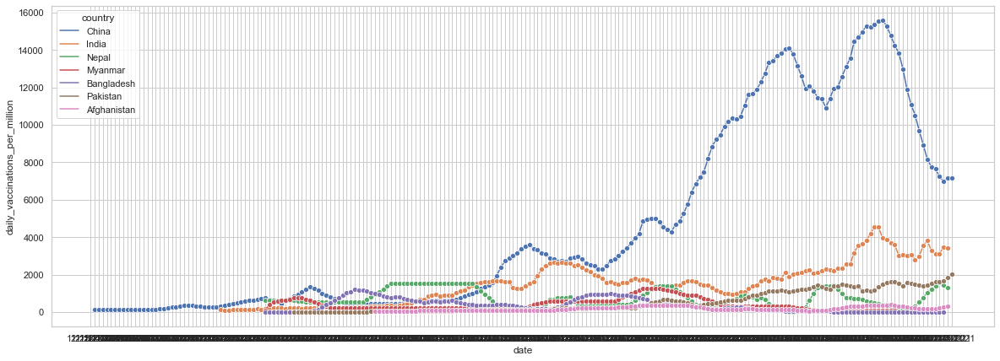

In [65]:
plt.figure(figsize=(20,7))
sns.lineplot(data=df2,x="date",y="daily_vaccinations_per_million",marker='o',hue="country")
plt.show()

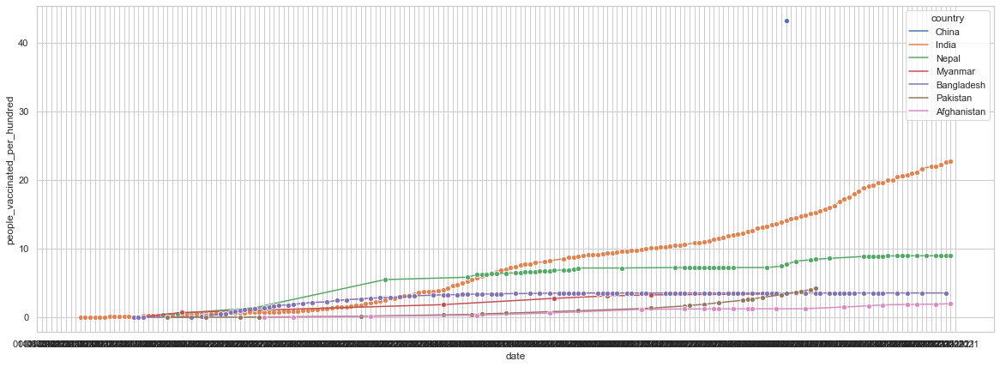

In [66]:
plt.figure(figsize=(20,7))
sns.lineplot(data=df2,x="date",y="people_vaccinated_per_hundred",marker='o',hue="country")
plt.show()

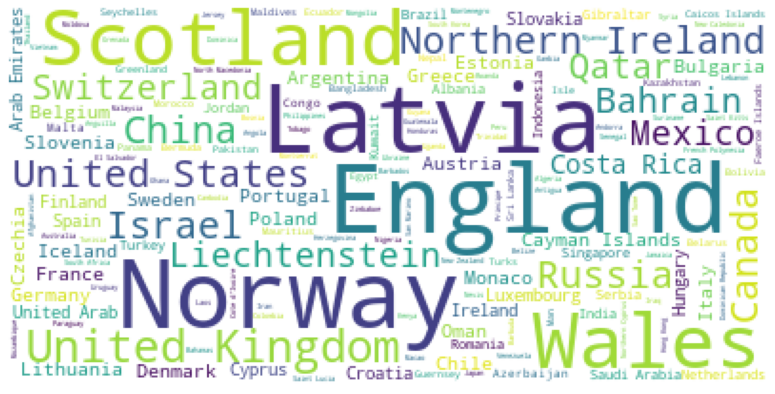

In [67]:
def size(m,n):
    fig = plt.gcf();
    fig.set_size_inches(m,n);
    
wordCloud = WordCloud(
    background_color='white',
    max_font_size = 50).generate(' '.join(df.country))
plt.figure(figsize=(15,7))
plt.axis('off')
plt.imshow(wordCloud)
plt.show()

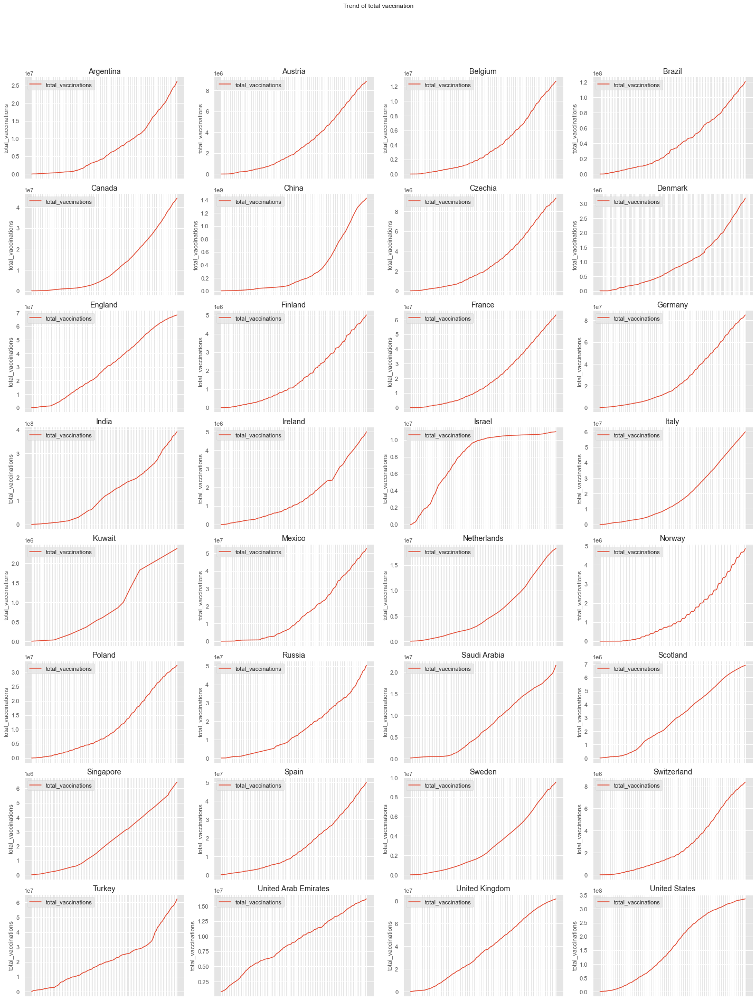

In [68]:
def plot_trend(dataframe,feature,title,country):
    plt.style.use('ggplot')
    plt.figure(figsize=(20,25))
    
    for i,country in enumerate(country):
        plt.subplot(8,4,i+1)
        data = dataframe[dataframe['country'] == country]
        sns.lineplot(x=data['date'] ,y=data[feature],label = feature)
        plt.xlabel('')
        plt.tick_params(axis='x',which='both',top=False,bottom=False,labelbottom=False)
        plt.title(country)
        
    plt.suptitle(title,y=1.05)
    plt.tight_layout()
    plt.show()

country = ['Argentina', 'Austria', 'Belgium', 'Brazil','Canada','China','Czechia',
           'Denmark', 'England','Finland', 'France','Germany','India','Ireland', 
           'Israel', 'Italy', 'Kuwait','Mexico', 'Netherlands','Norway', 'Poland',
           'Russia','Saudi Arabia', 'Scotland','Singapore','Spain', 'Sweden',
           'Switzerland', 'Turkey','United Arab Emirates', 'United Kingdom', 'United States']
plot_trend(df,'total_vaccinations','Trend of total vaccination',country)

In [69]:
country_wise_total_vaccinated = {}
for country in df.country.unique() : 
    vaccinated = 0
    for i in range(len(df)) : 
        if df.country[i] == country : 
            vaccinated += df.daily_vaccinations[i]
    country_wise_total_vaccinated[country] = vaccinated 
#     made a seperate dict from the df 
    country_wise_total_vaccinated_df = pd.DataFrame.from_dict(country_wise_total_vaccinated,
                                                         orient='index',
                                                         columns = ['total_vaccinted_till_date'])
#     converted dict to df 
country_wise_total_vaccinated_df.sort_values(by = 'total_vaccinted_till_date', ascending = False, inplace = True)
country_wise_total_vaccinated_df

,total_vaccinted_till_date
Norway,NaN
Latvia,NaN
England,NaN
Scotland,NaN
United Kingdom,NaN
...,...
Vanuatu,NaN
Burkina Faso,NaN
Chad,NaN
Pitcairn,NaN


## Train your model

In [70]:
from sklearn.preprocessing import MultiLabelBinarizer


tdf = df.copy()
tdf = tdf.dropna(subset=['vaccines'])

vac_df = tdf.groupby(['iso_code','vaccines']).max().reset_index()
vac_df['vaccines_split'] = vac_df['vaccines'].apply(lambda x: [w.strip() for w in x.split(',')])

one_hot = MultiLabelBinarizer()

vac_data = one_hot.fit_transform(vac_df['vaccines_split'])
vac_names = one_hot.classes_
vac_countries = vac_df['country']

final_vac_df = pd.DataFrame(data=vac_data, columns=vac_names, index=vac_countries)
final_vac_df = final_vac_df.reset_index()
final_vac_df.head()

,country,Abdala,CanSino,Covaxin,EpiVacCorona,Johnson&Johnson,Moderna,Oxford/AstraZeneca,Pfizer/BioNTech,QazVac,RBD-Dimer,Sinopharm/Beijing,Sinopharm/HayatVax,Sinopharm/Wuhan,Sinovac,Soberana02,Sputnik V
0,Aruba,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0
1,Afghanistan,0,0,0,0,1,0,1,1,0,0,1,0,0,0,0,0
2,Angola,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0
3,Anguilla,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0
4,Albania,0,0,0,0,0,0,1,1,0,0,0,0,0,1,0,1


In [71]:
from sklearn.preprocessing import MultiLabelBinarizer

one_hot = MultiLabelBinarizer()

vac_data = one_hot.fit_transform(vac_df['vaccines_split'])
vac_names = one_hot.classes_
vac_countries = vac_df['country']

final_vac_df = pd.DataFrame(data=vac_data, columns=vac_names, index=vac_countries)
final_vac_df = final_vac_df.reset_index()
final_vac_df.head()

,country,Abdala,CanSino,Covaxin,EpiVacCorona,Johnson&Johnson,Moderna,Oxford/AstraZeneca,Pfizer/BioNTech,QazVac,RBD-Dimer,Sinopharm/Beijing,Sinopharm/HayatVax,Sinopharm/Wuhan,Sinovac,Soberana02,Sputnik V
0,Aruba,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0
1,Afghanistan,0,0,0,0,1,0,1,1,0,0,1,0,0,0,0,0
2,Angola,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0
3,Anguilla,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0
4,Albania,0,0,0,0,0,0,1,1,0,0,0,0,0,1,0,1


In [72]:
cols_data = []
total_data = []
df_by_country = []
for country in np.unique(df['country']):
    df_by_country.append(df[df['country']==country])

def bars(data, x, y, title, figsize=(20, 12), rotation=75, size=8, width=None, height=None, colour=None):
    count = pd.DataFrame({x:data[x], y:data[y]}).sort_values(ascending=False, by=y)
    if not colour == None:
        c = count[colour]
    else:
        c = None
    fig = px.bar(count, x=x, y=y, title=title, width=width, height=height, color=c)
    fig.show()
    
def scatter(countries, col, threshold):
    i = 0
    fig = go.Figure()
    for country in countries:
        if list(df[df['country']==country][col])[-1]<threshold:
            if i % 2 == 0:
                i += 1
                continue
        i += 1
        df_temp = df[df['country']==country]
        trace = go.Scatter(x=df_temp['date'], y=df_temp[col], 
                           name=country,
                           mode='markers+lines')
        fig.add_trace(trace)
    fig.update_layout(legend_title=dict(text='Countries', font=dict(family="sans-serif",
                                         size=18)))
    fig.update_xaxes(title='date')
    fig.update_yaxes(title=col)
    fig.show()
    
def pie(data, x, y, title):
    data = pd.DataFrame({x:data.keys(), y:data.values()}).sort_values(ascending=False, by=y)
    fig = px.pie(data, values=y, names=x)
    fig.update_layout(legend_title=dict(text=title, font=dict(family="sans-serif",
                                         size=18)))
    fig.show()
    
def nulls(name, threshold, length):
    countries = np.array([])
    usable = 0
    for i in df_by_country:
        i = i.reset_index(drop=True)
        col = i[name]
        num_null = col.isnull().sum()
        col_len = len(col.index)
        usability = round(num_null/col_len*100, 2)<threshold
        if usability and col_len>length:
            usable += 1
            countries = np.append(countries, i['country'][0])
    return countries, name



def last_item(col):
    total_vaccs = []
    for country in df_by_country:
        total_vaccs.append(np.array(country[col])[-1])
    data = dict(zip(np.unique(df['country']), total_vaccs))
    return data

def preprocess(col, x, y):
    count = Counter(df[col])
    count = pd.DataFrame({x:count.keys(), y:count.values()}).sort_values(ascending=False, by=y)
    count = dict(zip(count[x], count[y]))
    return count

def bar_pre(col, values):
    k = 0
    for i in df[col]:
        country = df['country'][k]
        for j in i.split(', '):
            if j in values:
                values[j].append(country)
        k += 1
    return values

def bar_col(name, values, colour=False):
    col_data = bar_pre(name, values)
    cols_data.append(list(col_data.keys()))
    temp = []
    for point in list(col_data.keys()):
        column = 'days using '+point
        count = Counter(col_data[point])
        data = pd.DataFrame({'countries':count.keys(), column:count.values()})
        temp.append(data)
        if colour:
            c = column
        else:
            c = None
        bars(data, 'countries', column, 'Countries who use '+point, colour=c)
    total_data.append(temp)

In [73]:

count = Counter(df['source_name'])
count = pd.DataFrame({'name':count.keys(), 'value':count.values()})
count = count[count['value']>50]
bars(count, x='name', y='value', title='sources', width=800, height=600, colour='value')

In [74]:
data = last_item('total_vaccinations')
data = pd.DataFrame({'countries':data.keys(), 'total_vaccinations':data.values()})
data = data[data['total_vaccinations']>130000]
bars(data, 'countries', 'total_vaccinations', 'total_vaccinations per country', height=1000, colour='total_vaccinations')

In [75]:
data = last_item('people_fully_vaccinated')
data = pd.DataFrame({'countries':data.keys(), 'people_fully_vaccinated':data.values()})
data = data[data['people_fully_vaccinated']>50000]
bars(data, 'countries', 'people_fully_vaccinated', 'people_fully_vaccinated per country', 
     width=600, height=650, colour='people_fully_vaccinated')

In [76]:
bar_col('vaccines', {'Pfizer/BioNTech':[], 'Covaxin':[], 'Oxford/AstraZeneca':[], 
                                       'Moderna':[], 'Sinopharm/Beijing':[], 
                                        'Sinopharm/Wuhan':[], 'Sputnik V':[], 'Sinovac':[]},
       colour=True)

In [77]:
bar_col('source_name', {'Ministry of Health':[], 'Government of the United Kingdom':[], 
                            'National Health Commission':[], 'National Health Service':[]},
       colour=True)

In [78]:
for country in ['United States', 'China', 'United Kingdom']:
    df_temp = df[df['country']==country]
    fig = go.Figure()
    fig.add_trace(go.Scatter(x=df_temp['date'], y=df_temp['total_vaccinations'],
                             mode='markers+lines'))
    
    fig.update_layout(title_text=country)
    fig.update_xaxes(title='Date')
    fig.update_yaxes(title='Total vaccinations')
    fig.show()

In [79]:
for i in [['total_vaccinations', 10, 15, 1000000],
          ['total_vaccinations_per_hundred', 10, 15, 11],
          ['daily_vaccinations', 2.5, 20, 200000],
          ['daily_vaccinations_per_million', 2.05, 20, 0],
          ['people_fully_vaccinated', 60, 20, 500000],
          ['people_fully_vaccinated_per_hundred', 60, 20, 4]]:
    countries, title = nulls(i[0], i[1], i[2])
    scatter(countries, title, i[3])

In [80]:
count = Counter(df['vaccines'])
count = pd.Series(count).sort_values(ascending=False)[:10]
count = dict(zip(count.keys(), count))
pie(count, 'vaccine', 'days using vaccine', '10 most used vaccine combinations')

In [81]:
countries = ['United States', 'China', 'United Kingdom', 'India', 'Israel']
results = [[], []]
for country in countries:
    count = Counter(df[df['country']==country]['vaccines'])
    result = pd.DataFrame({'Vaccines':count.keys(), 'Days using vaccines':count.values()})
    pie(count, 'Vaccines', 'Days using vaccines', country)

In [82]:
df['year'] = [int(i.split('-')[0]) for i in df['date']]
df['month'] = [int(i.split('-')[1]) for i in df['date']]
df['day'] = [int(i.split('-')[2]) for i in df['date']]

for col in df:
    df[col] = df[col].fillna(0)

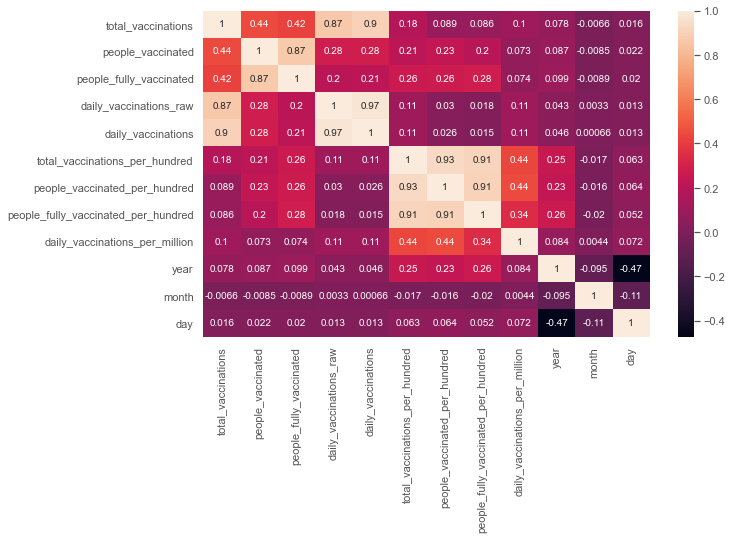

In [83]:
fig, ax = plt.subplots(1, 1, figsize=(10, 6))
sns.heatmap(df.corr(), annot=True)
plt.show()

In [84]:
X = df.drop(['total_vaccinations', 'people_vaccinated', 'iso_code', 'date', 'source_website'], axis=1)
y = df['total_vaccinations']
X = X.merge(pd.get_dummies(X['source_name']), left_index=True, right_index=True).drop('source_name', axis=1)
X = X.merge(pd.get_dummies(X['vaccines']), left_index=True, right_index=True).drop('vaccines', axis=1)
X = X.drop('country', axis=1)


X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2)
model_names = ['XGBRegressor', 'RandomForestRegressor', 'ElasticNet', 'Lasso', 'Ridge', 'SVR']
score_list = []
r2_list = []
mae_list = []
mse_list = []

for model in [XGBRegressor(), RandomForestRegressor(), ElasticNet(), Lasso(), Ridge(), SVR()]:
    model.fit(X_train, y_train)
    y_pred = model.predict(X_test)
    
    score = model.score(X_test, y_test)
    r2 = r2_score(y_test, y_pred)
    mae = mean_absolute_error(y_test, y_pred)
    mse = mean_squared_error(y_test, y_pred)
    
    score_list.append(score)
    r2_list.append(r2)
    mae_list.append(mae)
    mse_list.append(mse)

In [85]:
results = pd.DataFrame({'score':score_list, 'r2':r2_list, 'mae':mae_list, 'mse':mse_list})
results.index = model_names
for col in results:
    temp_results = results.sort_values(by=col, ascending=False)
    fig = px.bar(temp_results, temp_results.index, col,
                 title=col, color=results[col])
    fig.show()

## Send us the Result (Maktabkhoone)